In [1]:
import json
import os
import pandas as pd
from collections import defaultdict 
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image, ImageDraw 
import numpy as np

In [2]:
train_path = "za_traffic_2020/traffic_train"
test_path = "za_traffic_2020/traffic_public_test"

In [3]:

with open(os.path.join(train_path, "train_traffic_sign_dataset.json"), "r") as f:
    trainData = json.load(f)

In [4]:
trainData["images"]

[{'file_name': '3.png', 'height': 626, 'width': 1622, 'id': 3, 'street_id': 3},
 {'file_name': '5.png', 'height': 626, 'width': 1622, 'id': 5, 'street_id': 4},
 {'file_name': '6.png', 'height': 626, 'width': 1622, 'id': 6, 'street_id': 5},
 {'file_name': '16.png',
  'height': 626,
  'width': 1622,
  'id': 16,
  'street_id': 3},
 {'file_name': '17.png',
  'height': 626,
  'width': 1622,
  'id': 17,
  'street_id': 8},
 {'file_name': '18.png',
  'height': 626,
  'width': 1622,
  'id': 18,
  'street_id': 3},
 {'file_name': '21.png',
  'height': 626,
  'width': 1622,
  'id': 21,
  'street_id': 4},
 {'file_name': '22.png',
  'height': 626,
  'width': 1622,
  'id': 22,
  'street_id': 8},
 {'file_name': '25.png',
  'height': 626,
  'width': 1622,
  'id': 25,
  'street_id': 7},
 {'file_name': '28.png',
  'height': 626,
  'width': 1622,
  'id': 28,
  'street_id': 4},
 {'file_name': '29.png',
  'height': 626,
  'width': 1622,
  'id': 29,
  'street_id': 7},
 {'file_name': '32.png',
  'height': 626

In [5]:
filename = []
imgSize = []
for i in trainData["images"]:
    filename.append(i["file_name"])
    imgSize.append((i["width"],i["height"]))
    

In [6]:
df1 = pd.DataFrame({"img_id" : filename, "imgSize" : imgSize})
df1.head()

,img_id,imgSize
0,3.png,"(1622, 626)"
1,5.png,"(1622, 626)"
2,6.png,"(1622, 626)"
3,16.png,"(1622, 626)"
4,17.png,"(1622, 626)"


In [7]:
df1.shape


(4500, 2)

In [8]:
image_info = defaultdict(list) 
for i in trainData["annotations"]:
    image_info[i["image_id"]].append((i["area"], i["bbox"], i["category_id"]))
image_info
    

defaultdict(list,
            {3: [(342, [880, 333, 19, 18], 2)],
             5: [(6889, [1069, 355, 83, 83], 3), (63, [768, 480, 9, 7], 2)],
             6: [(255, [781, 337, 17, 15], 6)],
             16: [(56, [733, 352, 7, 8], 2)],
             17: [(5400, [1024, 160, 75, 72], 2)],
             18: [(1927, [1138, 295, 47, 41], 2),
              (99, [986, 371, 11, 9], 3),
              (48, [979, 363, 8, 6], 2),
              (1558, [290, 295, 38, 41], 5)],
             21: [(484, [822, 314, 22, 22], 3), (48, [697, 321, 8, 6], 2)],
             22: [(18200, [1021, 140, 140, 130], 2)],
             25: [(3591, [1097, 137, 63, 57], 3),
              (208, [860, 222, 16, 13], 2),
              (221, [858, 208, 17, 13], 5)],
             28: [(624, [320, 438, 26, 24], 2), (169, [775, 455, 13, 13], 2)],
             29: [(160, [965, 202, 10, 16], 2)],
             32: [(121, [586, 238, 11, 11], 6)],
             33: [(3481, [400, 361, 59, 59], 4)],
             35: [(1640, [228, 186, 4

In [9]:
images = []
bbox_coord = []
bbox_area = []
bbox_category = []
for image in image_info:
    images.append(image)
    # [bbox area, category, coord]
    area = []
    coord = []
    category = []
    for bbox in image_info[image]:
        area.append(bbox[0])
        coord.append(bbox[1])
        category.append(bbox[2])
    bbox_coord.append(coord)
    bbox_area.append(area)
    bbox_category.append(category)


In [10]:
df2 = pd.DataFrame({"img_id" : images, "bbox_coord" : bbox_coord, "bbox_area": bbox_area, "bbox_category": bbox_category})
df2.head()

,img_id,bbox_coord,bbox_area,bbox_category
0,3,"[[880, 333, 19, 18]]",[342],[2]
1,5,"[[1069, 355, 83, 83], [768, 480, 9, 7]]","[6889, 63]","[3, 2]"
2,6,"[[781, 337, 17, 15]]",[255],[6]
3,16,"[[733, 352, 7, 8]]",[56],[2]
4,17,"[[1024, 160, 75, 72]]",[5400],[2]


In [11]:
df2["img_id"] = df2["img_id"].apply(lambda x: str(x)+".png")
df2.head()

,img_id,bbox_coord,bbox_area,bbox_category
0,3.png,"[[880, 333, 19, 18]]",[342],[2]
1,5.png,"[[1069, 355, 83, 83], [768, 480, 9, 7]]","[6889, 63]","[3, 2]"
2,6.png,"[[781, 337, 17, 15]]",[255],[6]
3,16.png,"[[733, 352, 7, 8]]",[56],[2]
4,17.png,"[[1024, 160, 75, 72]]",[5400],[2]


In [12]:
df = pd.merge(df1, df2, on = "img_id")

In [13]:
df.head()

,img_id,imgSize,bbox_coord,bbox_area,bbox_category
0,3.png,"(1622, 626)","[[880, 333, 19, 18]]",[342],[2]
1,5.png,"(1622, 626)","[[1069, 355, 83, 83], [768, 480, 9, 7]]","[6889, 63]","[3, 2]"
2,6.png,"(1622, 626)","[[781, 337, 17, 15]]",[255],[6]
3,16.png,"(1622, 626)","[[733, 352, 7, 8]]",[56],[2]
4,17.png,"(1622, 626)","[[1024, 160, 75, 72]]",[5400],[2]


# Analysis Data

In [14]:
df["num_box"] = df["bbox_coord"].apply(lambda x: len(x))
df.head()

,img_id,imgSize,bbox_coord,bbox_area,bbox_category,num_box
0,3.png,"(1622, 626)","[[880, 333, 19, 18]]",[342],[2],1
1,5.png,"(1622, 626)","[[1069, 355, 83, 83], [768, 480, 9, 7]]","[6889, 63]","[3, 2]",2
2,6.png,"(1622, 626)","[[781, 337, 17, 15]]",[255],[6],1
3,16.png,"(1622, 626)","[[733, 352, 7, 8]]",[56],[2],1
4,17.png,"(1622, 626)","[[1024, 160, 75, 72]]",[5400],[2],1


In [ ]:
df.to_csv("Traffic")

<AxesSubplot:>

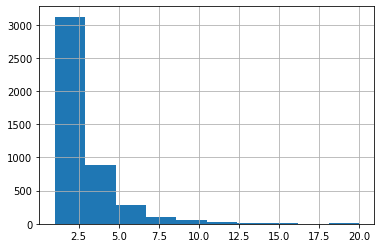

In [15]:
df["num_box"].hist()

In [16]:
bbox_area_ls = []
for bbox_a in df["bbox_area"]:
    bbox_area_ls.append(bbox_a)


(0.0, 58607.58935834811)

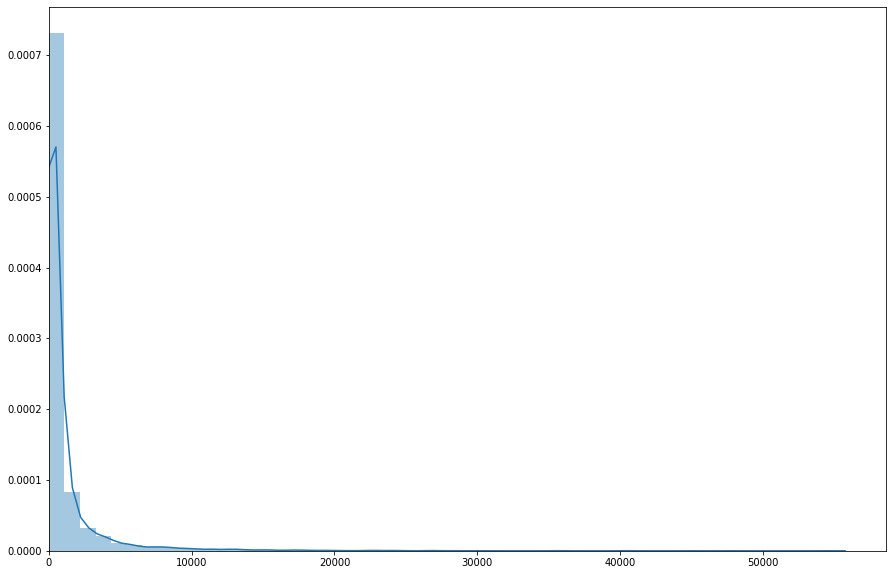

In [17]:
flatten_bbox = [i for j in bbox_area_ls for i in j]
fig = plt.figure(figsize = (15, 10))
sns.distplot(flatten_bbox)
plt.xlim(0, )

In [58]:
def visualise(image_fn, bbox):
    if( isinstance(image_fn, str) ):
        img = Image.open(image_fn).convert('RGBA')
    else:
        img = ToPILImage()(image_fn.squeeze(0))
    bbox_canvas = Image.new('RGBA', img.size)
    bbox_draw = ImageDraw.Draw(bbox_canvas)
    for box in bbox:
        x, y, w, h = box[0], box[1], box[2], box[3]
        bbox_draw.rectangle((x, y, x+w, y+h), fill=(255, 255, 255, 0), outline=(255, 0, 0, 255), width = 5)
    img = Image.alpha_composite(img, bbox_canvas)
    img = img.convert("RGB") # Remove alpha for saving in jpg format.
    viz_img = np.asarray(img)
    plt.figure(figsize=(15, 15))
    plt.title(image_fn)
    plt.imshow(viz_img)
    plt.show()
def get_all_bboxes(df, image_id):
    image_bboxes = df[df.img_id == image_id]["bbox_coord"].values
    
    bboxes = []
    for box in image_bboxes:
        bboxes.append(box)
        
    return bboxes
def gen_all_category(df, image_id):
    img_c = df[df.img_id == image_id]["bbox_category"].values
    category = []
    for c in img_c:
        category.append(c)
    return category

In [19]:
def crop_bbox(image_id, bbox_coord, category):
    img = Image.open(image_id).convert('RGBA')
    num_box = len(bbox_coord)
    for box, c in zip(bbox_coord, category):
        x, y, w, h = box[0], box[1], box[2], box[3]
        name = convert_category[c]
        crop_img = img.crop((x, y, x+w, y+h))
        plt.title(name)
        plt.imshow(crop_img)
        plt.show()


    

In [20]:
df_new = df[["img_id", "bbox_coord", "bbox_area", "bbox_category"]].set_index(['img_id']).apply(pd.Series.explode).reset_index()


In [21]:
convert_category = {1: "No entry",
2: "No parking / waiting",
3: "No turning",
4: "Max Speed",
5: "Other prohibition signs",
6: "Warning",
7:"Mandatory"}

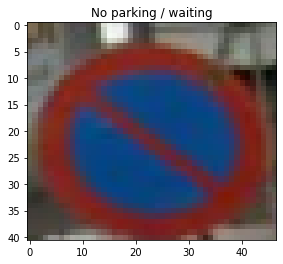

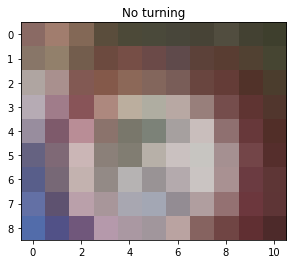

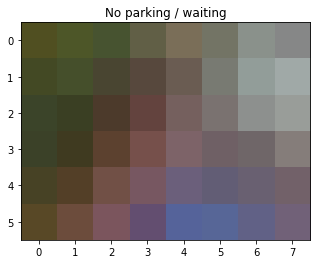

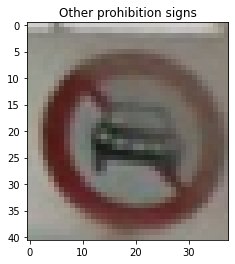

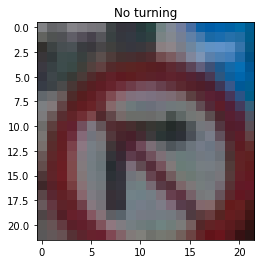

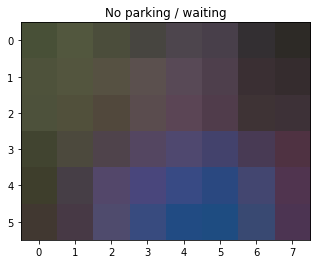

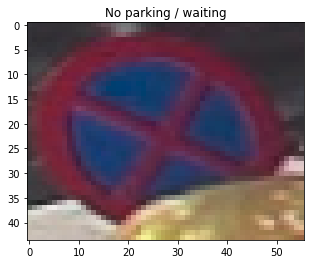

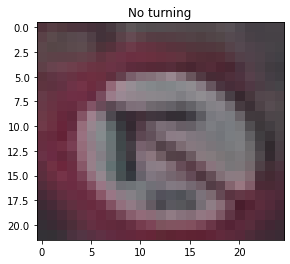

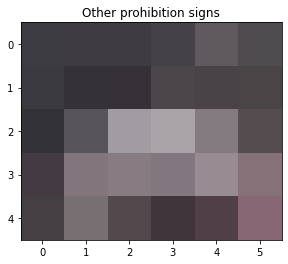

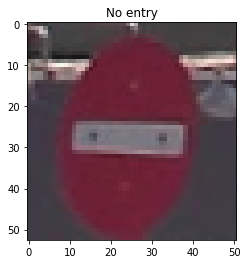

In [61]:
image_path = os.path.join(train_path, "images")
bbox_small_area = df_new[df_new["bbox_area"] < 50]["img_id"].values
for idx, img in enumerate(bbox_small_area):
    bbox = get_all_bboxes(df_new, img)
    category = gen_all_category(df_new, img)
#     visualise(os.path.join(image_path, img), bbox)
    crop_bbox(os.path.join(image_path, img), bbox, category)
    if(idx == 2):
        break

In [62]:
print("Num box cant detect: ", len(bbox_small_area))

Num box cant detect:  1304


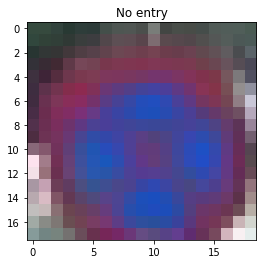

In [25]:
crop_bbox(os.path.join(image_path, "3.png"), [[880, 333, 19, 18]], [1])


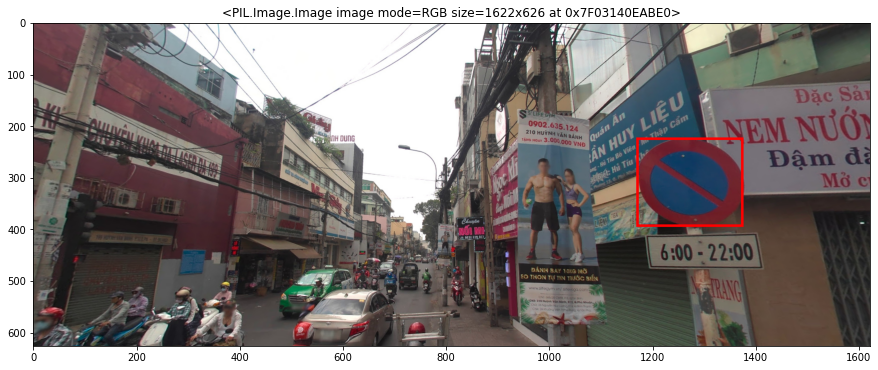

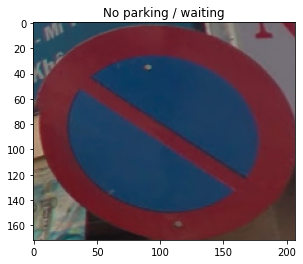

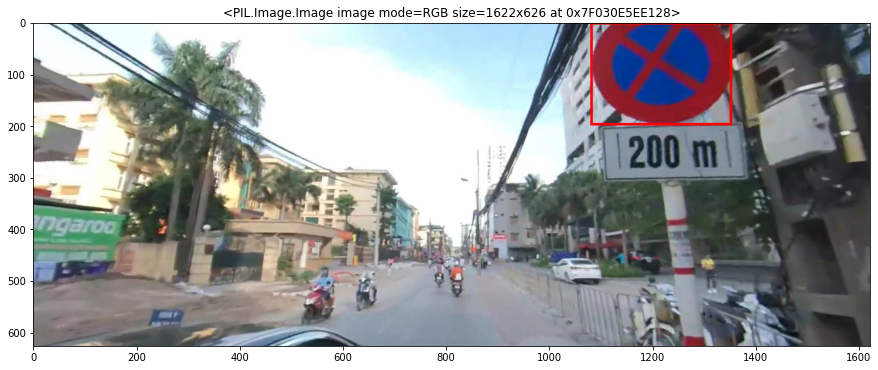

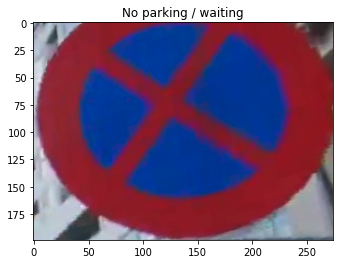

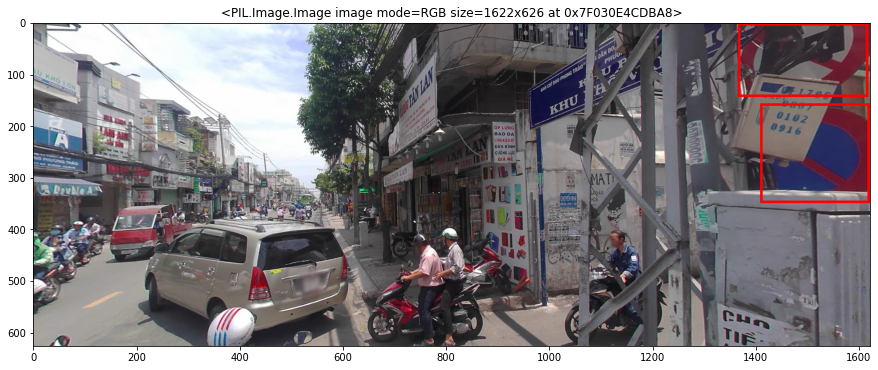

...

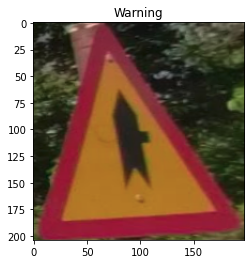

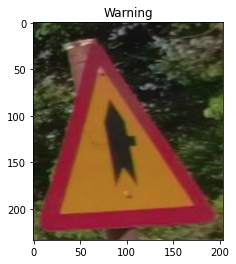

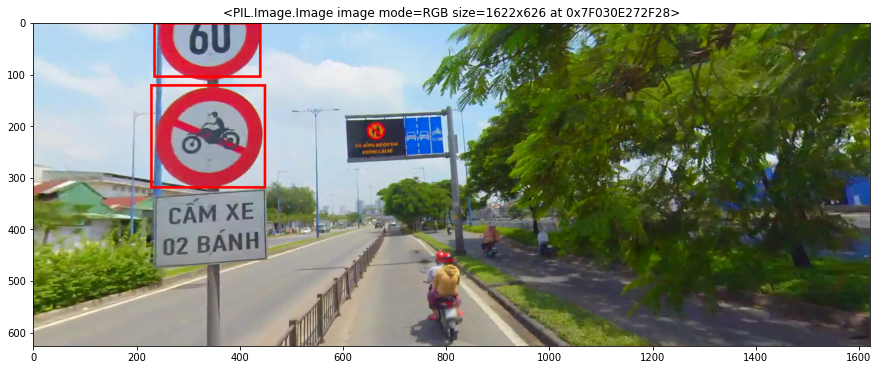

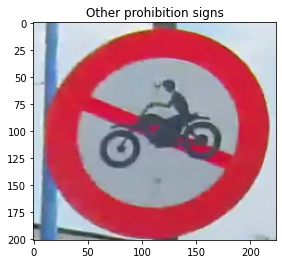

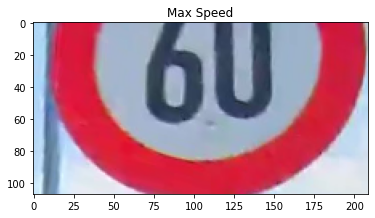

In [27]:
bbox_big_area = df_new[df_new["bbox_area"] > 30000]["img_id"].values
for idx, img in enumerate(bbox_big_area):
    bbox = get_all_bboxes(df_new, img)
    category = gen_all_category(df_new, img)
    visualise(os.path.join(image_path, img), bbox)
    crop_bbox(os.path.join(image_path, img), bbox, category)
    if(idx == 10):
        break

# Check Brightness of images

In [29]:
import cv2

In [48]:
def get_image_brightness(image):
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # get average brightness
    return np.array(gray).mean()
def add_brightness(df):
    brightness = []
    img_ids = []
    for _, row in df.iterrows():
        img_id = row.img_id 
        image = cv2.imread(image_path + "/" + img_id)
        brightness.append(get_image_brightness(image))
        img_ids.append(img_id)
    
    brightness_df = pd.DataFrame({"img_id": img_ids, "brightness": brightness})
    return brightness_df

In [49]:
brightness_df = add_brightness(df_new)
brightness_df.head()

,img_id,brightness
0,3.png,115.860797
1,5.png,127.403100
2,5.png,127.403100
3,6.png,112.206444
4,16.png,102.707951


In [50]:
br_df = pd.merge(brightness_df, df_new, on = "img_id")
br_df

,img_id,brightness,bbox_coord,bbox_area,bbox_category
0,3.png,115.860797,"[880, 333, 19, 18]",342,2
1,5.png,127.403100,"[1069, 355, 83, 83]",6889,3
2,5.png,127.403100,"[768, 480, 9, 7]",63,2
3,5.png,127.403100,"[1069, 355, 83, 83]",6889,3
4,5.png,127.403100,"[768, 480, 9, 7]",63,2
...,...,...,...,...,...
47319,12523.png,130.990650,"[800, 281, 21, 16]",336,6
47320,12523.png,130.990650,"[969, 335, 15, 16]",240,4
47321,12523.png,130.990650,"[800, 256, 20, 21]",420,2
47322,12523.png,130.990650,"[800, 281, 21, 16]",336,6


(array([0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.600e+01, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00,
        1.000e+01, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00,
        6.000e+00, 5.000e+00, 8.000e+00, 2.000e+00, 1.000e+01, 4.000e+00,
        9.000e+00, 1.000e+01, 0.000e+00, 1.460e+02, 1.000e+01, 1.040e+02,
        1.600e+01, 1.140e+02, 6.700e+01, 5.500e+01, 1.130e+02, 1.500e+01,
        1.900e+01, 3.300e+01, 1.630e+02, 3.700e+01, 1.170e+02, 1.000e+02,
        1.780e+02, 1.990e+02, 7.200e+01, 7.080e+02, 1.060e+02, 1.440e+02,
        1.420e+02, 1.780e+02, 1.010e+02, 3.880e+02, 7.850e+02, 2.730e+02,
        1.190e+02, 3.630e+02, 2.540e+0

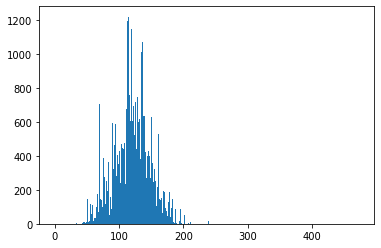

In [54]:
his_range = np.arange(br_df.shape[0]/100)
plt.hist(br_df["brightness"], his_range)

# Get images with low brightness

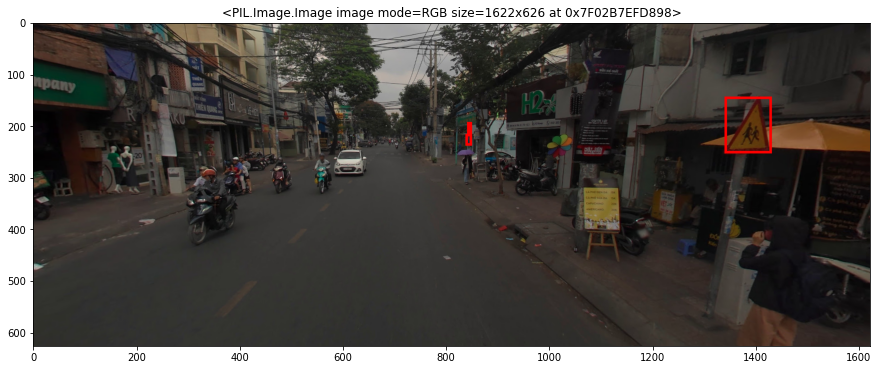

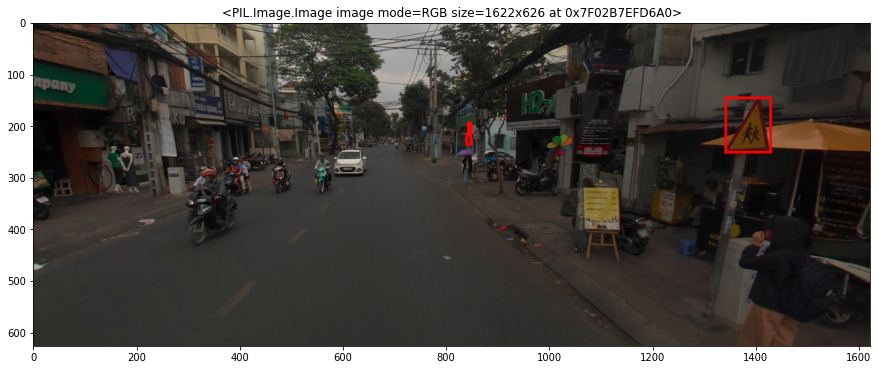

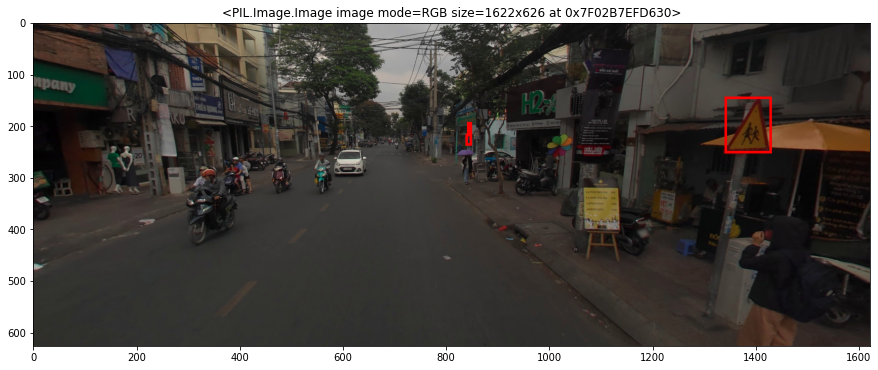

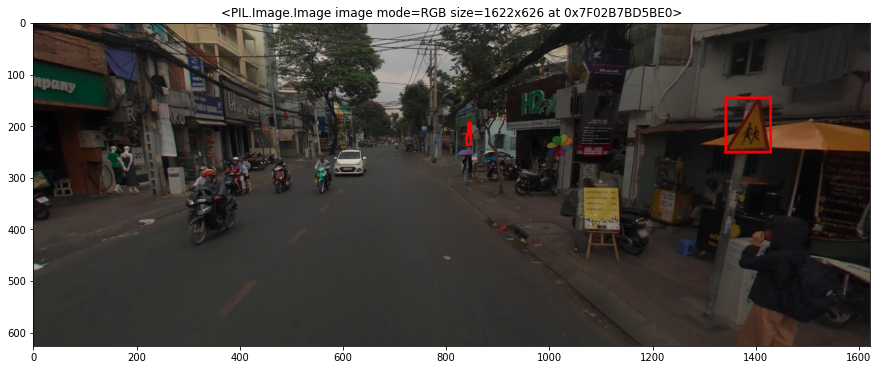

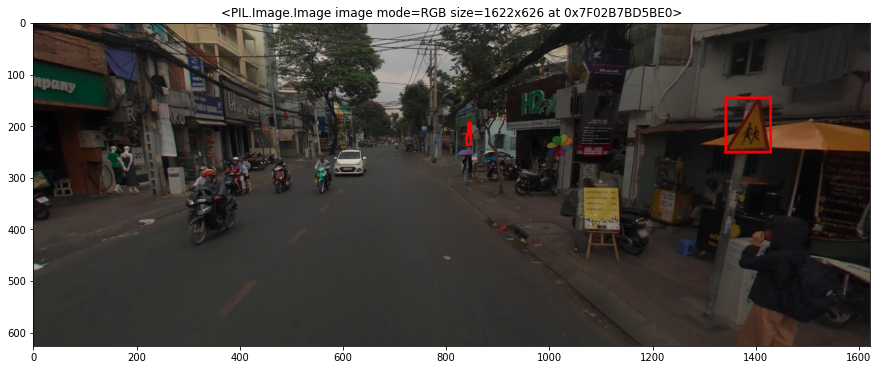

...

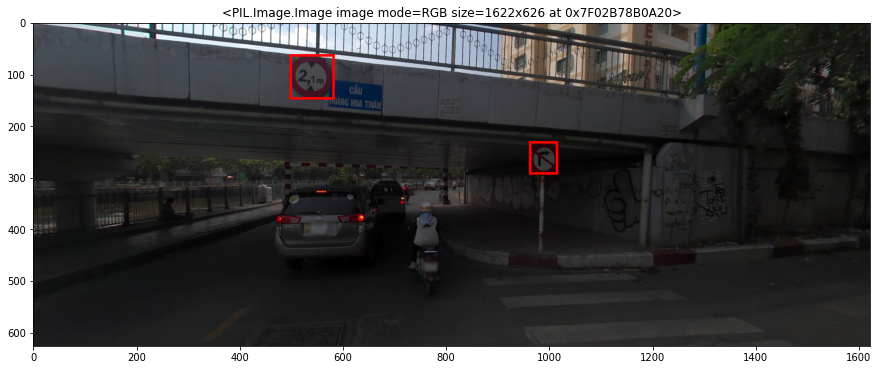

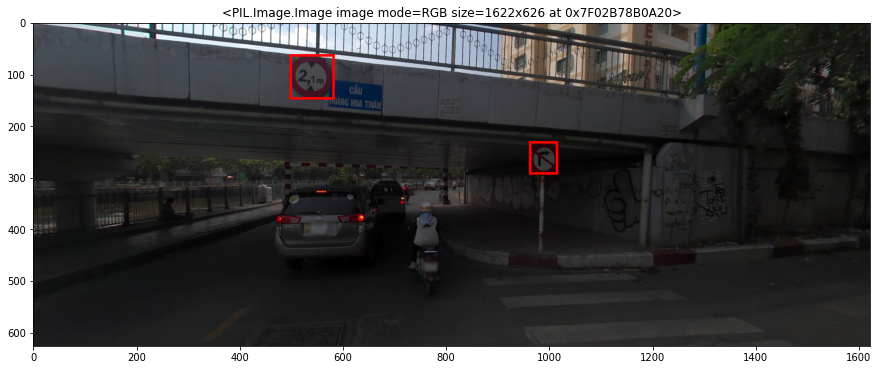

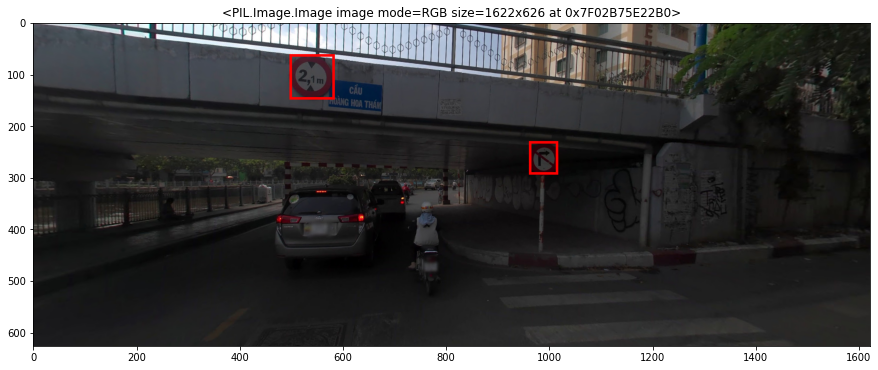

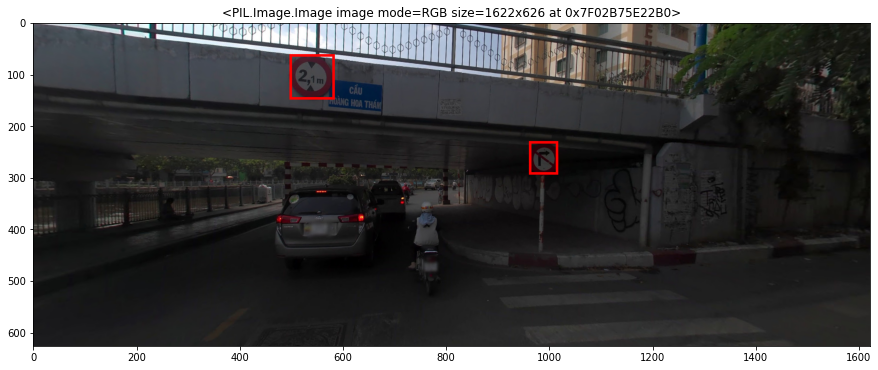

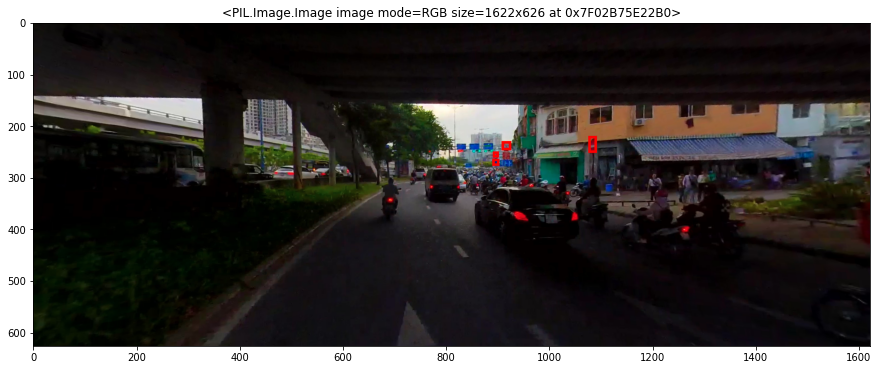

In [56]:
dark_image = br_df[br_df["brightness"] < 50].img_id
for idx, img in enumerate(dark_image):
    bbox = get_all_bboxes(df_new, img)
    category = gen_all_category(df_new, img)
    visualise(os.path.join(image_path, img), bbox)
#     crop_bbox(os.path.join(image_path, img), bbox, category)
    if(idx == 20):
        break

# Get images with hight brightness

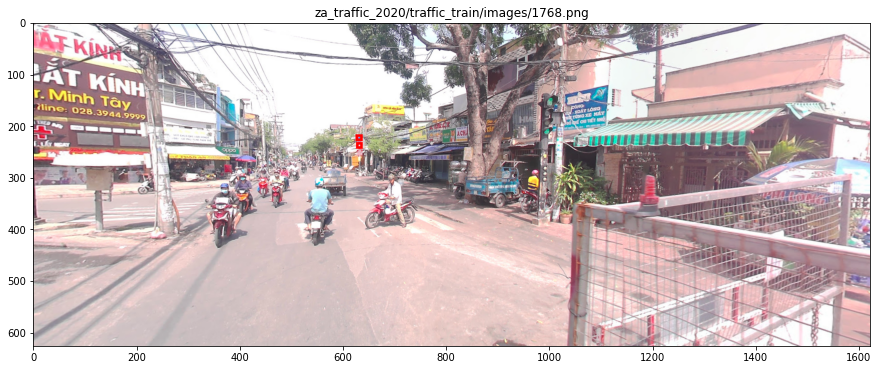

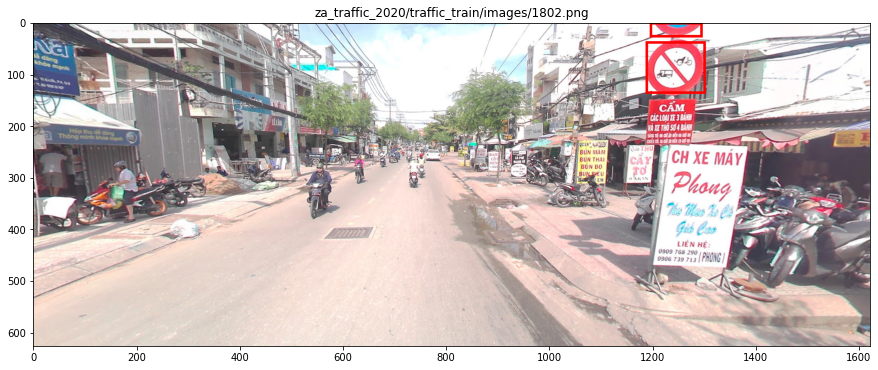

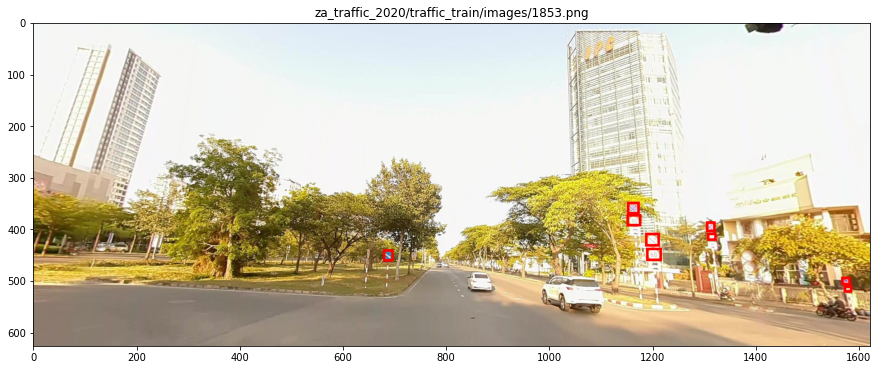

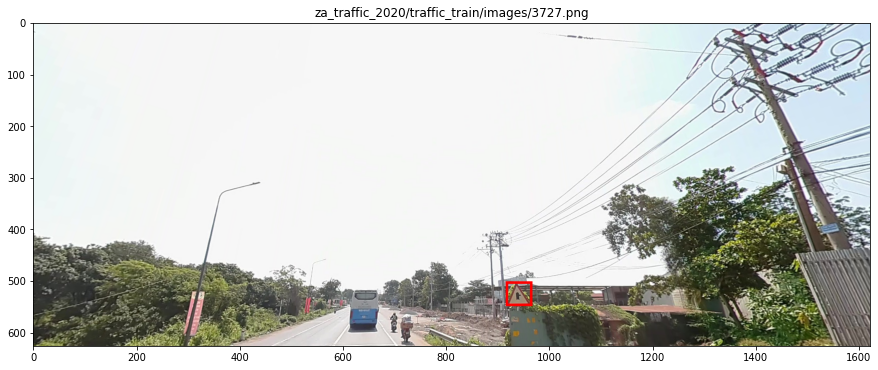

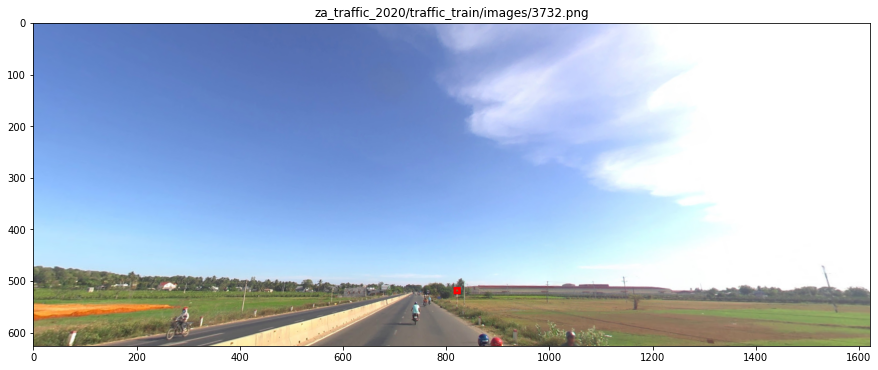

...

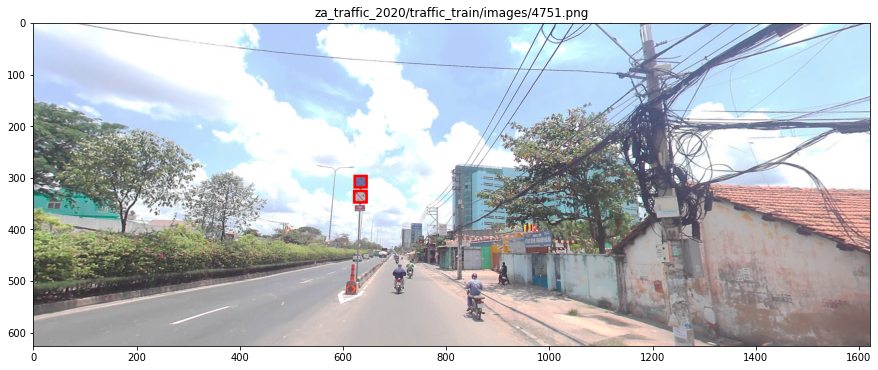

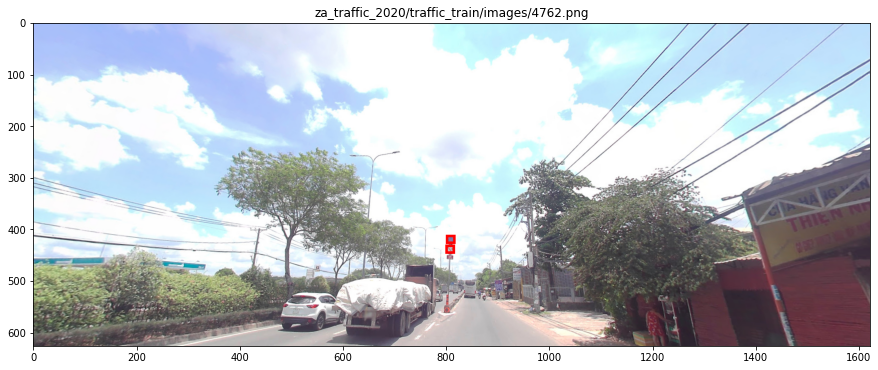

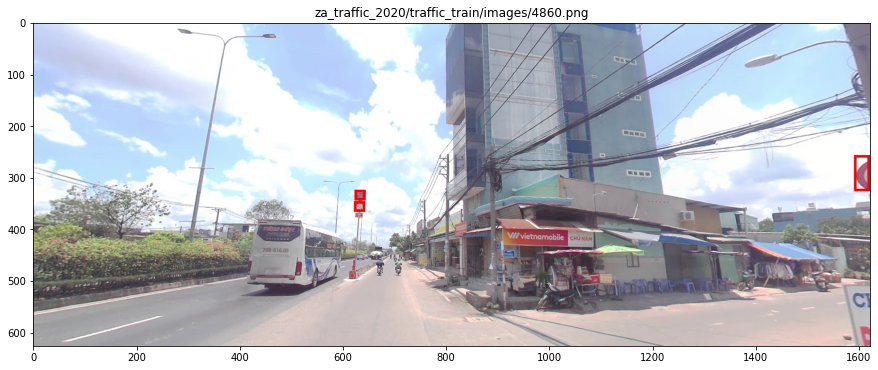

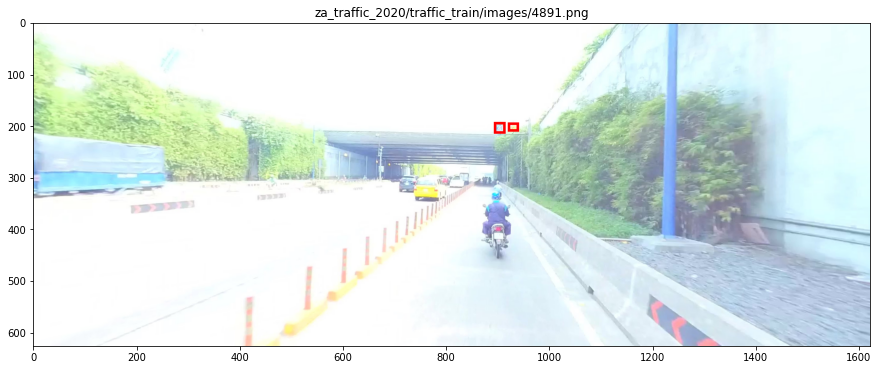

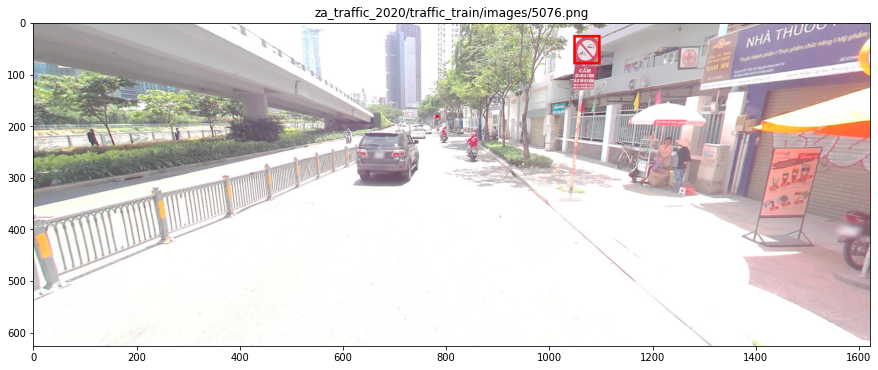

In [60]:
bright_image = br_df[br_df["brightness"] > 180].img_id.unique()
for idx, img in enumerate(bright_image):
    bbox = get_all_bboxes(df_new, img)
    category = gen_all_category(df_new, img)
    visualise(os.path.join(image_path, img), bbox)
#     crop_bbox(os.path.join(image_path, img), bbox, category)
    if(idx == 20):
        break